In [1]:
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
import sklearn
from sklearn.datasets import load_boston
import os

# What is Multicollinearity?

Multicollinearity occurs when two or more independent variables are highly correlated with one another in a regression model.

This means that an independent variable can be predicted from another independent variable in a regression model. For example, height and weight, household income and water consumption, mileage and price of a car, study time and leisure time, etc.

Let me take a simple example from our everyday life to explain this. Colin loves watching television while munching on chips. The more television he watches, the more chips he eats and the happier he gets!

Now, if we could quantify happiness and measure Colin’s happiness while he’s busy doing his favorite activity, which do you think would have a greater impact on his happiness? Having chips or watching television? That’s difficult to determine because the moment we try to measure Colin’s happiness from eating chips, he starts watching television. And the moment we try to measure his happiness from watching television, he starts eating chips.

Eating chips and watching television are highly correlated in the case of Colin and we cannot individually determine the impact of the individual activities on his happiness. This is the multicollinearity problem!

So why should you worry about multicollinearity in the machine learning context? Let’s answer that question next.

The Problem with having Multicollinearity
Multicollinearity can be a problem in a regression model because we would not be able to distinguish between the individual effects of the independent variables on the dependent variable. For example, let’s assume that in the following linear equation:

```Y = W0+W1*X1+W2*X2```

Coefficient W1 is the increase in Y for a unit increase in X1 while keeping X2 constant. But since X1 and X2 are highly correlated, changes in X1 would also cause changes in X2 and we would not be able to see their individual effect on Y.

“ This makes the effects of X1 on Y difficult to distinguish from the effects of X2 on Y. ”

Multicollinearity may not affect the accuracy of the model as much. But we might lose reliability in determining the effects of individual features in your model – and that can be a problem when it comes to interpretability.

 

# What causes Multicollinearity?

Multicollinearity could occur due to the following problems:

Multicollinearity could exist because of the problems in the dataset at the time of creation. These problems could be because of poorly designed experiments, highly observational data, or the inability to manipulate the data:
For example, determining the electricity consumption of a household from the household income and the number of electrical appliances. Here, we know that the number of electrical appliances in a household will increase with household income. However, this cannot be removed from the dataset
Multicollinearity could also occur when new variables are created which are dependent on other variables:
For example, creating a variable for BMI from the height and weight variables would include redundant information in the model
Including identical variables in the dataset:
For example, including variables for temperature in Fahrenheit and temperature in Celsius
Inaccurate use of dummy variables can also cause a multicollinearity problem. This is called the Dummy variable trap:
For example, in a dataset containing the status of marriage variable with two unique values: ‘married’, ’single’. Creating dummy variables for both of them would include redundant information. We can make do with only one variable containing 0/1 for ‘married’/’single’ status.
Insufficient data in some cases can also cause multicollinearity problems


# Detecting Multicollinearity using VIF

In [2]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

def calc_vif(X):

    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = df.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    return(vif)

# Read the data...

In [3]:
os.getcwd()

'c:\\Users\\ankan\\Desktop\\boston\\notebooks'

In [4]:
df = pd.read_csv('C:\\Users\\ankan\\Desktop\\boston\\data_given\\Boston.csv')

In [5]:
df.head()

,Unnamed: 0,crim,zn,indus,chas,nox,rm,age,dis,rad,tax,ptratio,black,lstat,medv
0,1,0.00632,18.0,2.31,0,0.538,6.575,65.2,4.0900,1,296,15.3,396.90,4.98,24.0
1,2,0.02731,0.0,7.07,0,0.469,6.421,78.9,4.9671,2,242,17.8,396.90,9.14,21.6
2,3,0.02729,0.0,7.07,0,0.469,7.185,61.1,4.9671,2,242,17.8,392.83,4.03,34.7
3,4,0.03237,0.0,2.18,0,0.458,6.998,45.8,6.0622,3,222,18.7,394.63,2.94,33.4
4,5,0.06905,0.0,2.18,0,0.458,7.147,54.2,6.0622,3,222,18.7,396.90,5.33,36.2


In [6]:
df.drop(columns= "Unnamed: 0", axis = 1, inplace= True)

In [7]:
df.head()

,crim,zn,indus,chas,nox,rm,age,dis,rad,tax,ptratio,black,lstat,medv
0,0.00632,18.0,2.31,0,0.538,6.575,65.2,4.0900,1,296,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0,0.469,6.421,78.9,4.9671,2,242,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0,0.469,7.185,61.1,4.9671,2,242,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0,0.458,6.998,45.8,6.0622,3,222,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0,0.458,7.147,54.2,6.0622,3,222,18.7,396.90,5.33,36.2


In [8]:
df.describe()

,crim,zn,indus,chas,nox,rm,age,dis,rad,tax,ptratio,black,lstat,medv
count,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000
mean,3.613524,11.363636,11.136779,0.069170,0.554695,6.284634,68.574901,3.795043,9.549407,408.237154,18.455534,356.674032,12.653063,22.532806
std,8.601545,23.322453,6.860353,0.253994,0.115878,0.702617,28.148861,2.105710,8.707259,168.537116,2.164946,91.294864,7.141062,9.197104
min,0.006320,0.000000,0.460000,0.000000,0.385000,3.561000,2.900000,1.129600,1.000000,187.000000,12.600000,0.320000,1.730000,5.000000
25%,0.082045,0.000000,5.190000,0.000000,0.449000,5.885500,45.025000,2.100175,4.000000,279.000000,17.400000,375.377500,6.950000,17.025000
50%,0.256510,0.000000,9.690000,0.000000,0.538000,6.208500,77.500000,3.207450,5.000000,330.000000,19.050000,391.440000,11.360000,21.200000
75%,3.677083,12.500000,18.100000,0.000000,0.624000,6.623500,94.075000,5.188425,24.000000,666.000000,20.200000,396.225000,16.955000,25.000000
max,88.976200,100.000000,27.740000,1.000000,0.871000,8.780000,100.000000,12.126500,24.000000,711.000000,22.000000,396.900000,37.970000,50.000000


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 14 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   crim     506 non-null    float64
 1   zn       506 non-null    float64
 2   indus    506 non-null    float64
 3   chas     506 non-null    int64  
 4   nox      506 non-null    float64
 5   rm       506 non-null    float64
 6   age      506 non-null    float64
 7   dis      506 non-null    float64
 8   rad      506 non-null    int64  
 9   tax      506 non-null    int64  
 10  ptratio  506 non-null    float64
 11  black    506 non-null    float64
 12  lstat    506 non-null    float64
 13  medv     506 non-null    float64
dtypes: float64(11), int64(3)
memory usage: 55.5 KB


the value that we will have to predict is ```medv```

In [10]:
from pandas_profiling import ProfileReport
prof = ProfileReport(df)
prof.to_file(output_file='output.html')

Export report to file: 100%|██████████| 1/1 [00:00<00:00, 27.85it/s]


In [11]:
prof

In [12]:
df['chas'].unique()

array([0, 1], dtype=int64)

* zn is a useless feature as it has more than 70% zeros
* chas has only two categorical values as int64
* need to try transformations on indus, nox
* rad is also a cat feature
* indus and tax, ptratio might show multi-colinearity
* rm and age,might show multi-colinearity
* rm and dist,might show multi-colinearity
* rm and lstat,might show multi-colinearity

In [13]:
df['rad'].unique()

array([ 1,  2,  3,  5,  4,  8,  6,  7, 24], dtype=int64)

In [14]:
df.drop(columns='zn', axis =  1, inplace=True)

In [15]:
df.head()

,crim,indus,chas,nox,rm,age,dis,rad,tax,ptratio,black,lstat,medv
0,0.00632,2.31,0,0.538,6.575,65.2,4.0900,1,296,15.3,396.90,4.98,24.0
1,0.02731,7.07,0,0.469,6.421,78.9,4.9671,2,242,17.8,396.90,9.14,21.6
2,0.02729,7.07,0,0.469,7.185,61.1,4.9671,2,242,17.8,392.83,4.03,34.7
3,0.03237,2.18,0,0.458,6.998,45.8,6.0622,3,222,18.7,394.63,2.94,33.4
4,0.06905,2.18,0,0.458,7.147,54.2,6.0622,3,222,18.7,396.90,5.33,36.2


In [16]:
prof = ProfileReport(df)
prof.to_file(output_file='output(2).html')
prof

Export report to file: 100%|██████████| 1/1 [00:00<00:00, 28.65it/s]


In [17]:
df.shape

(506, 13)

In [18]:
X = df
calc_vif(X)

,variables,VIF
0,crim,2.107732
1,indus,14.322508
2,chas,1.176222
3,nox,73.970516
4,rm,135.126815
5,age,21.100393
6,dis,12.204430
7,rad,15.100016
8,tax,58.388439
9,ptratio,77.223718


``` we will look into it afterwards```

In [19]:
from sklearn import datasets
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error

In [31]:
X = df.drop('medv', axis = 1)
y = df['medv']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2, random_state=42)

reg_all = LinearRegression()
reg_all.fit(X_train, y_train)

# model evaluation for training set

y_train_predict = reg_all.predict(X_train)
rmse = (np.sqrt(mean_squared_error(y_train, y_train_predict)))
r2 = round(reg_all.score(X_train, y_train),2)

print("The model performance for training set")
print("--------------------------------------")
print('RMSE is {}'.format(rmse))
print('R2 score is {}'.format(r2))
print("\n")
print("---------------------------------------")
# model evaluation for test set

y_pred = reg_all.predict(X_test)
rmse = (np.sqrt(mean_squared_error(y_test, y_pred)))
r2 = round(reg_all.score(X_test, y_test),2)

print("The model performance for test set")
print("--------------------------------------")
print("Root Mean Squared Error: {}".format(rmse))
print("R^2: {}".format(r2))
print("\n")


The model performance for training set
--------------------------------------
RMSE is 4.673117996924144
R2 score is 0.75


---------------------------------------
The model performance for test set
--------------------------------------
Root Mean Squared Error: 5.066624958018867
R^2: 0.65




In [32]:
import pickle

# save
with open('C:\\Users\\ankan\\Desktop\\boston\\saved_models\\model.pkl','wb') as f:
    pickle.dump(reg_all,f)

In [33]:
%matplotlib inline

Text(0.5, 1.0, 'Actual Prices vs Predicted prices')

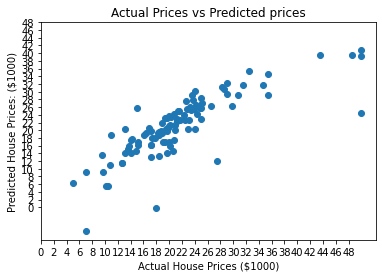

In [34]:
plt.scatter(y_test, y_pred)
plt.xlabel("Actual House Prices ($1000)")
plt.ylabel("Predicted House Prices: ($1000)")
plt.xticks(range(0, int(max(y_test)),2))
plt.yticks(range(0, int(max(y_test)),2))
plt.title("Actual Prices vs Predicted prices")

In [35]:
# Fitting Decision Tree Regression to the dataset
from sklearn.tree import DecisionTreeRegressor
regressor = DecisionTreeRegressor()
regressor.fit(X_train, y_train)

DecisionTreeRegressor()

In [36]:
y_pred = regressor.predict(X_test)

In [37]:
y_pred

array([28.1, 33.1, 15.2, 22. , 23.2, 18.5, 16.6, 16.7, 22.7, 22. , 18.8,
       18.3,  7.4, 20.6, 19. , 25. , 20.5, 10.5, 44. , 17.8, 22.2, 23.7,
       13.5, 22. , 13.8, 14.6, 21. , 13.5, 19.4, 20.8, 19.5, 23.1, 10.4,
       15. , 13.3, 15.6, 33. , 18.5, 22.5, 24.6, 19.8, 29.9, 44. , 19.3,
       22. , 13. , 14.3, 24.1, 17.4, 35.1, 20.1, 36.1, 16.6, 29.9, 43.1,
       19.9, 15.2, 27.9, 22.9, 22.5, 25.1, 33. , 29.4, 19.3, 28. , 14.4,
       15.4, 22.9, 27.9, 14.1, 21. , 28.7,  8.8, 18.6, 21.4, 10.5, 19.8,
       50. , 13.1,  8.1, 21. , 16.3, 19.4, 10.5, 16.2, 32. , 14.3, 23.1,
       20.6, 18.1, 23.3,  8.8, 19.8, 17.5, 15. , 19.8, 50. , 16.3, 11.7,
       16.3, 19. , 28.1])

In [38]:
data = pd.DataFrame({'Real Values':y_test, 'Predicted Values':y_pred})
data

,Real Values,Predicted Values
173,23.6,28.1
274,32.4,33.1
491,13.6,15.2
72,22.8,22.0
452,16.1,23.2
...,...,...
412,17.9,16.3
436,9.6,11.7
411,17.2,16.3
86,22.5,19.0


In [39]:
reg_all = DecisionTreeRegressor()
reg_all.fit(X_train, y_train)

# model evaluation for training set

y_train_predict = reg_all.predict(X_train)
rmse = (np.sqrt(mean_squared_error(y_train, y_train_predict)))
r2 = round(reg_all.score(X_train, y_train),2)

print("The model performance for training set")
print("--------------------------------------")
print('RMSE is {}'.format(rmse))
print('R2 score is {}'.format(r2))
print("\n")
print("---------------------------------------")
# model evaluation for test set

y_pred = reg_all.predict(X_test)
rmse = (np.sqrt(mean_squared_error(y_test, y_pred)))
r2 = round(reg_all.score(X_test, y_test),2)

print("The model performance for test set")
print("--------------------------------------")
print("Root Mean Squared Error: {}".format(rmse))
print("R^2: {}".format(r2))
print("\n")


The model performance for training set
--------------------------------------
RMSE is 0.0
R2 score is 1.0


---------------------------------------
The model performance for test set
--------------------------------------
Root Mean Squared Error: 3.4541818928683545
R^2: 0.84




Text(0.5, 1.0, 'Actual Prices vs Predicted prices')

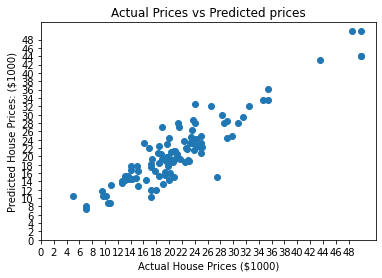

In [40]:
plt.scatter(y_test, y_pred)
plt.xlabel("Actual House Prices ($1000)")
plt.ylabel("Predicted House Prices: ($1000)")
plt.xticks(range(0, int(max(y_test)),2))
plt.yticks(range(0, int(max(y_test)),2))
plt.title("Actual Prices vs Predicted prices")

In [41]:
# save
with open('C:\\Users\\ankan\\Desktop\\boston\\saved_models\\model_final.pkl','wb') as f:
    pickle.dump(reg_all,f)